In [1]:
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import os
import torch
os.chdir("/home/prakyath/github/personal/lead-the-way/")

In [2]:
files_ = os.listdir('graph_store/')
print(files_)

['graph_data_4.gpickle', 'graph_data_2.gpickle', 'graph_data_3.gpickle', 'graph_data_1.gpickle']


In [3]:
graphs = []
last_nodes = []
first_nodes = []
for i in sorted(files_):
    graph = nx.read_gpickle('graph_store/' + i)
    graphs.append(graph)
    nodes = list(graph.nodes())
    first_nodes.append(nodes[1])
    last_nodes.append(nodes[-2])





In [4]:
print(first_nodes[1:], last_nodes[:-1])
graph = nx.compose_all(graphs)
for i, j in zip(first_nodes[1:], last_nodes[:-1]):
    graph.add_edge(i,j)

[34, 65, 96] [31, 62, 93]


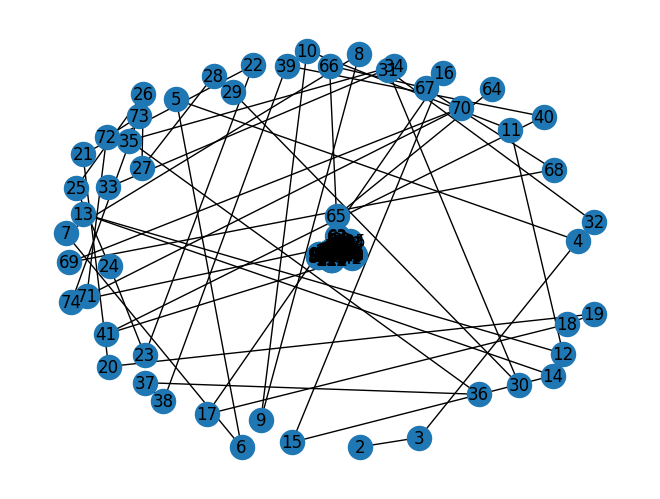

In [5]:
nx.draw(graph, with_labels = True)

# Combine the path

In [6]:
# combine the paths
cos = torch.nn.CosineSimilarity(dim=1, eps=1e-6)

In [97]:
edge_distances  =  {key: value  for key, value in nx.get_edge_attributes(graph, "distance").items() if len(value) > 0}

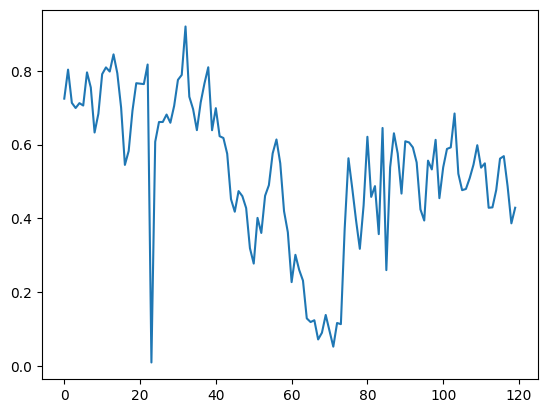

In [7]:
plotting_sims = []
for i in list(graph.nodes())[1:-3]:
    plotting_sims.append(cos(graph.nodes()[i]['features'], graph.nodes()[i + 1]['features']).cpu().numpy()[0])
plt.plot(plotting_sims)

In [8]:
i = 2
j = 3
save_nodes = []
while j < list(graph.nodes())[-1]:
    sim = cos(graph.nodes()[i]['features'], graph.nodes()[j]['features']).cpu().numpy()[0]
    print(sim)
    if sim < 0.6:
        save_nodes.append((i,j))
        i = j
        j = i + 1
    else:
        j += 1

print(save_nodes)

0.6810931
0.85211456
0.7659497
0.68751514
0.68967175
0.703495
0.76440513
0.7773793
0.7220763
0.6388772
0.74757874
0.7703103
0.7565455
0.781739
0.80007774
0.7293926
0.7717003
0.5409647
0.58255345
0.69158137
0.59749424
0.7648643
0.73247653
0.6985886
0.018536573
0.60739183
0.65800464
0.62729526
0.58858144
0.6589889
0.6234865
0.58301187
0.78850496
0.77132356
0.7022984
0.74429023
0.6450201
0.7051297
0.6442628
0.59709954
0.6387157
0.594659
0.6225139
0.5594629
0.5749073
0.45207995
0.4179536
0.4738056
0.4600911
0.42781454
0.31907415
0.2775544
0.40124083
0.36040846
0.4611997
0.48986968
0.5759541
0.61365753
0.6111314
0.41528344
0.3624451
0.22726685
0.30125576
0.26017907
0.2312732
0.12906605
0.119129285
0.12402605
0.07198719
0.09010368
0.13832664
0.095212504
0.052400313
0.11656627
0.11336399
0.37093288
0.5628037
0.4816053
0.39502895
0.31747854
0.4353165
0.62093806
0.45332426
0.48734087
0.35723153
0.6448239
0.2860902
0.53813267
0.6303953
0.48278683
0.46707064
0.60881317
0.45622027
0.59215677
0.551

In [9]:


edge_data = nx.get_edge_attributes(graph, "distance")
trajectory = {}
sum = []
counter = 0
for i in save_nodes:
    start_i = i[0]
    trajectory[i[0]] = [0,0,0]

    # combining the rotational matrix
    for j in range(i[0], i[1]):
        try:
            edge = edge_data[(j, j + 1)]
            trajectory[i[0]][0] += edge[0]
            trajectory[i[0]][1] += edge[1]
            trajectory[i[0]][2] += edge[2]
        except KeyError:
            print(i)
            pass
    # if the trajectory is same then del the key
    if trajectory[i[0]] == [0,0,0]:
        trajectory.pop(i[0])
    
     
    

(31, 34)
(63, 64)
(93, 95)


# Printing directions

[0.0, 3.48, 0.0]


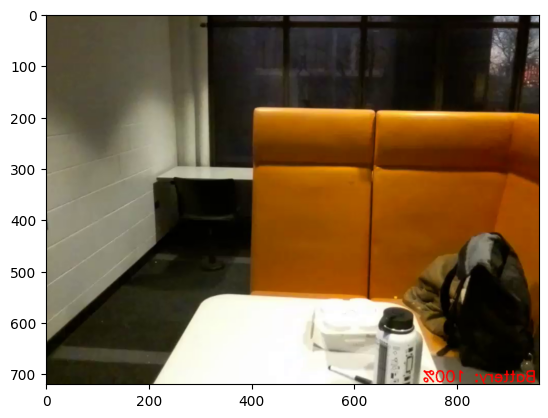

[0.0, 13.74, 0.0]


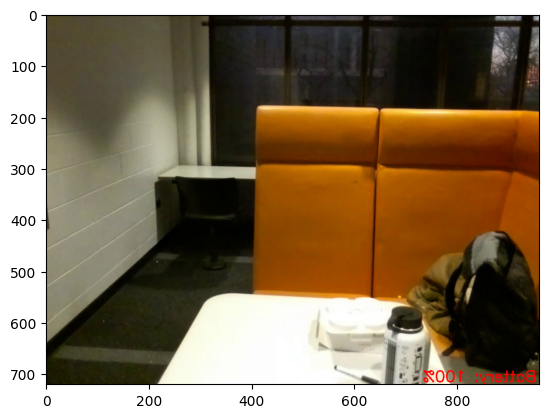

[0.0, 10.8, 0.0]


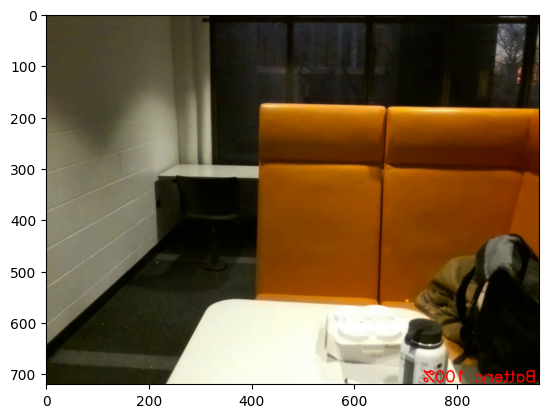

[0.0, 13.38, 0.0]


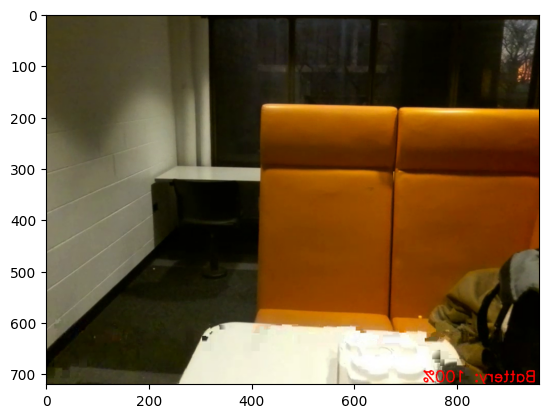

[0.0, 15.84, 0.0]


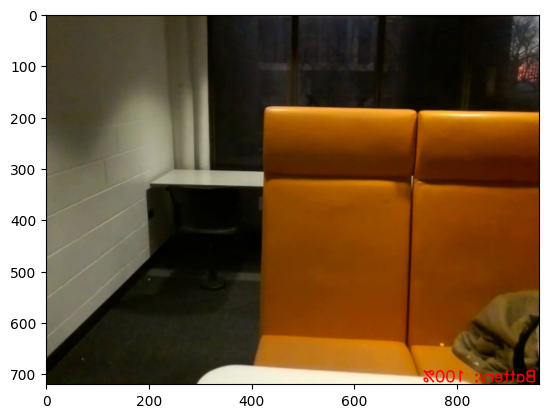

[0.0, 18.12, 0.0]


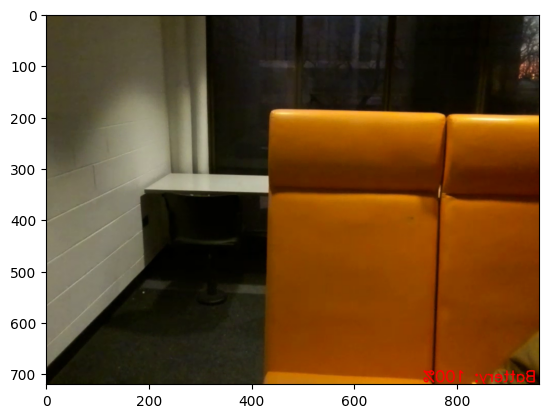

[0.0, 18.12, 0.0]


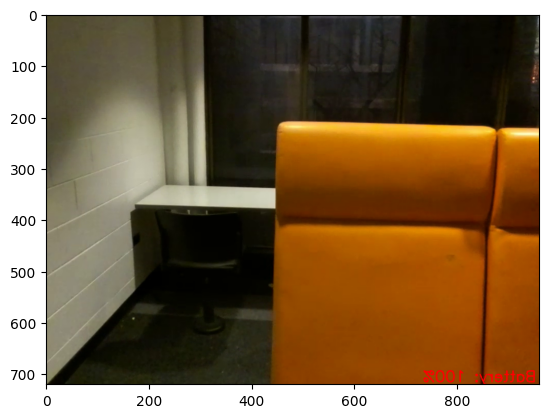

[0.0, 18.12, 0.0]


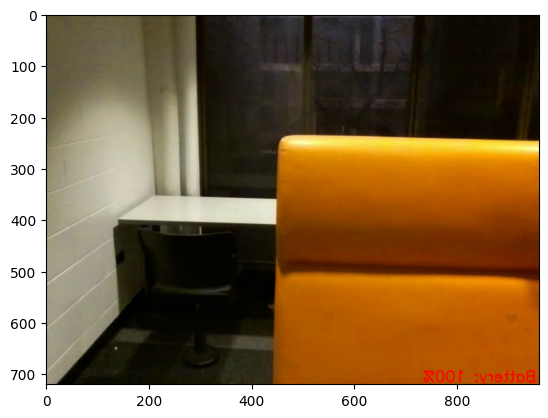

[0.0, 18.12, 0.0]


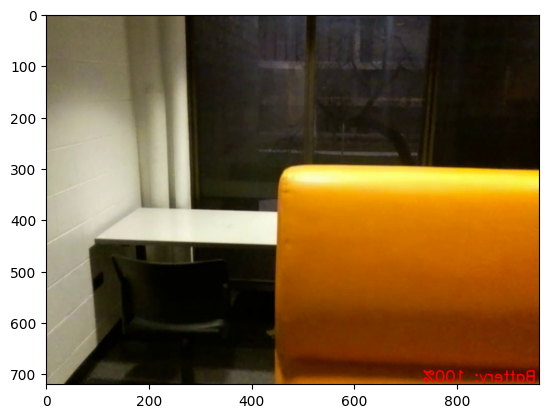

[0.0, 18.12, 0.0]


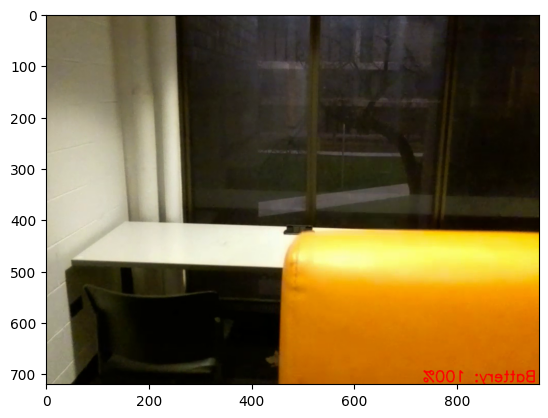

[0.0, 18.12, 0.0]


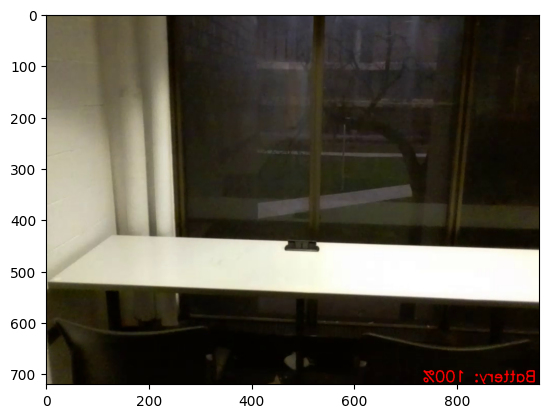

[0.0, 18.12, 0.0]


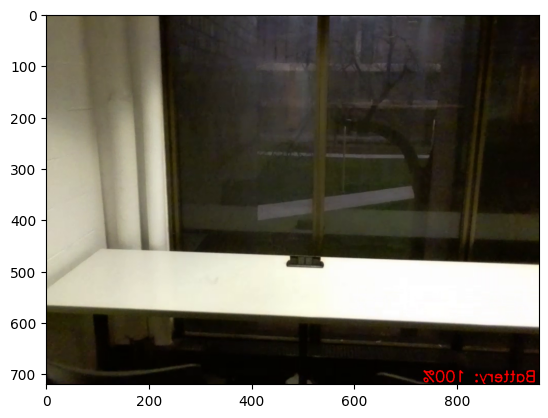

[0.0, 18.12, 0.0]


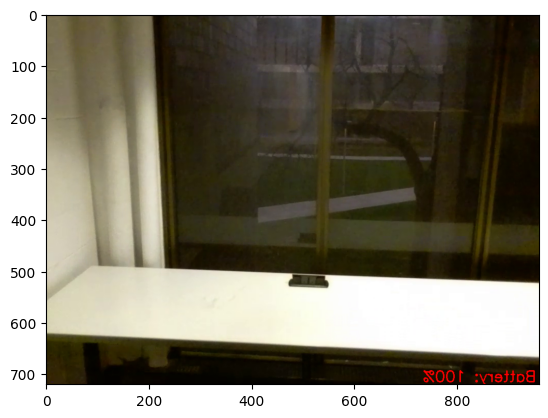

[0.0, 18.12, 0.0]


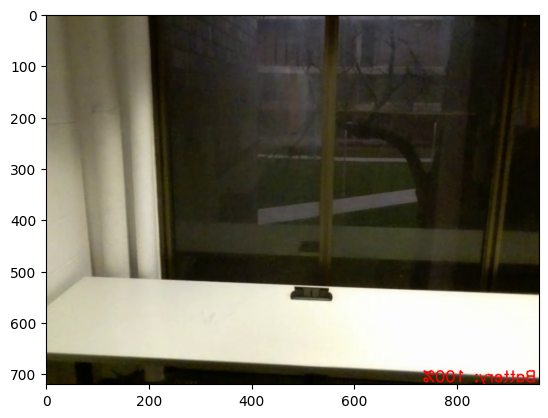

[-0.78, 18.12, 0.0]


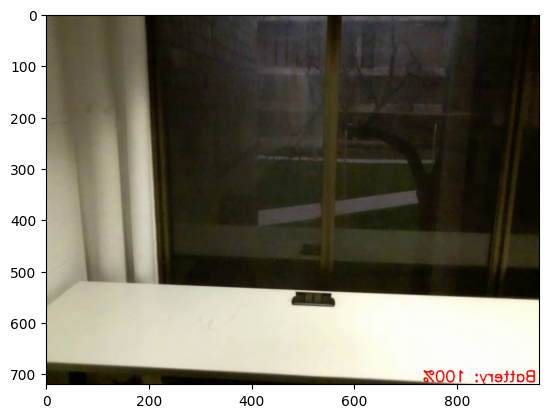

[-12.78, 54.36, 0.0]


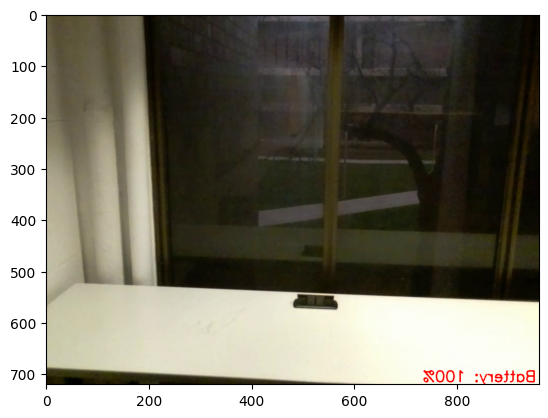

[-8.7, 18.12, 0.0]


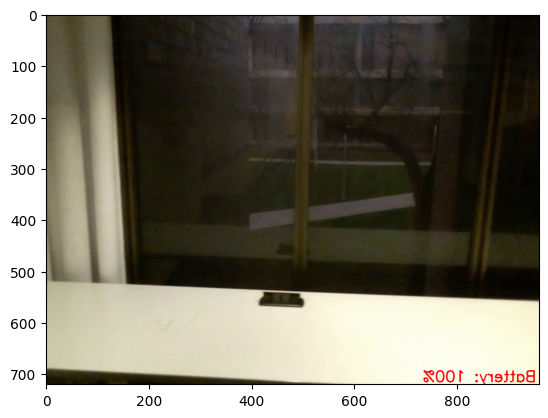

[0.0, 0.0, -1.74]


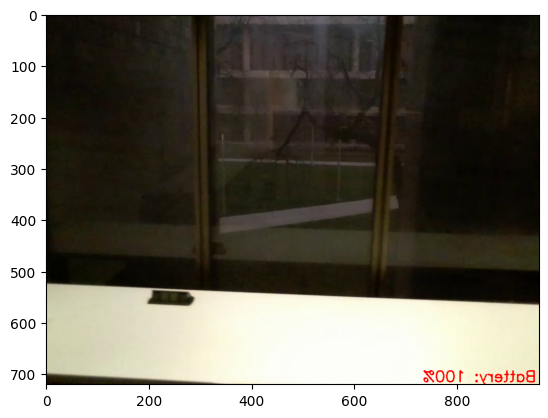

[0.0, 0.0, -4.38]


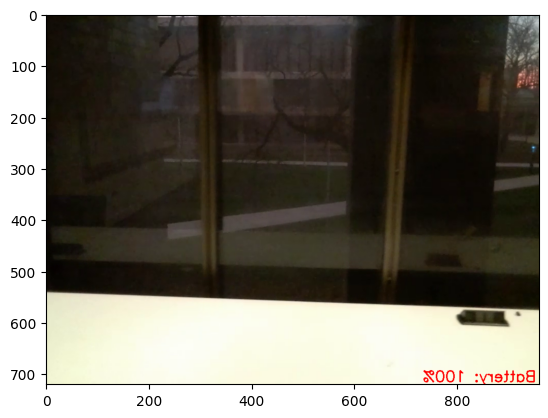

[0.0, 0.0, -7.2]


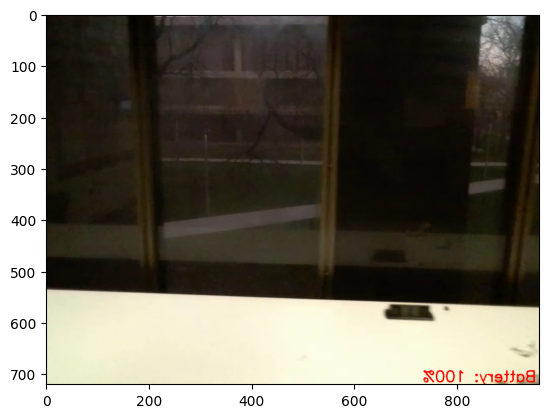

[0.0, 0.0, -9.72]


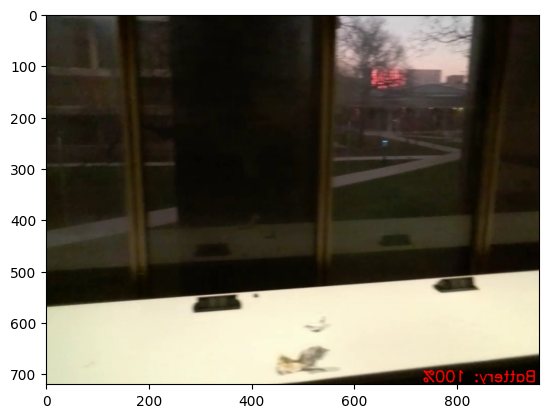

[0.0, 0.0, -12.54]


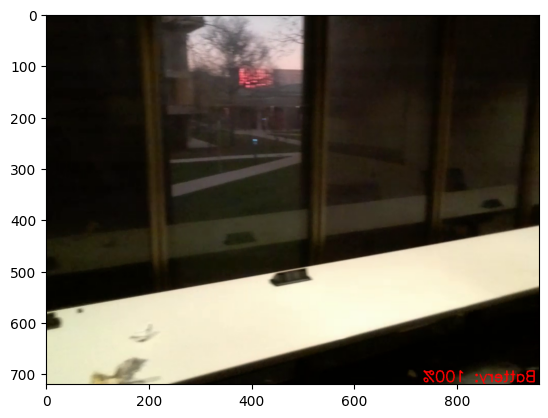

[0.0, 0.0, -14.94]


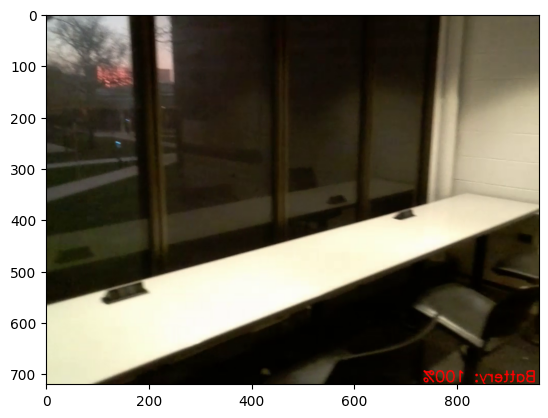

[0.0, 0.0, -17.52]


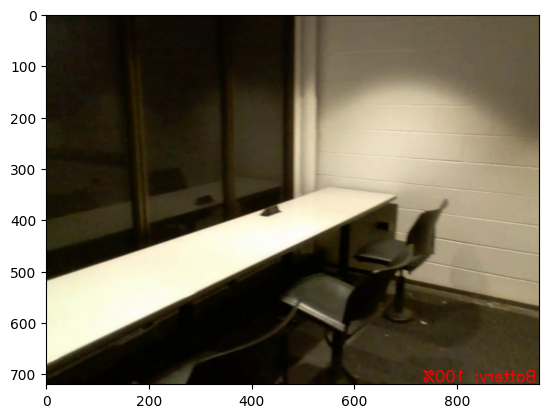

[0.0, 0.0, -20.16]


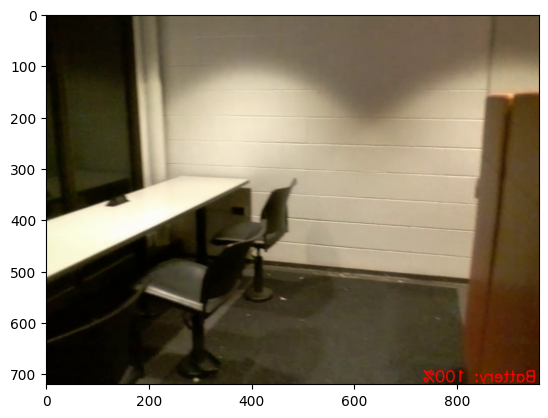

[0.0, 0.0, -22.56]


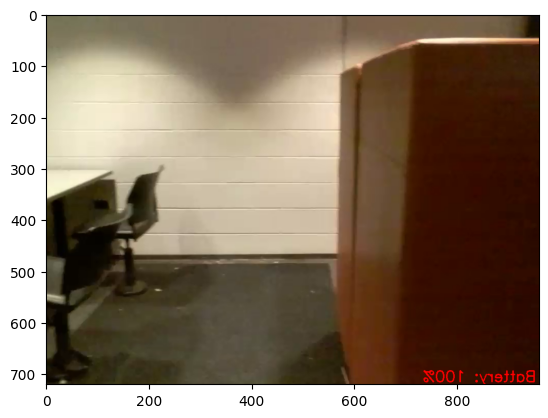

[0.0, 0.0, -25.14]


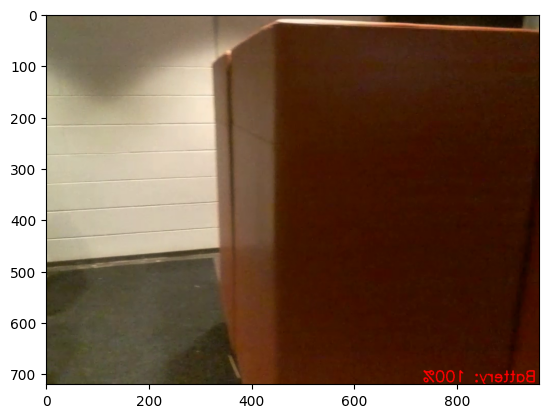

[0.0, 0.0, -27.78]


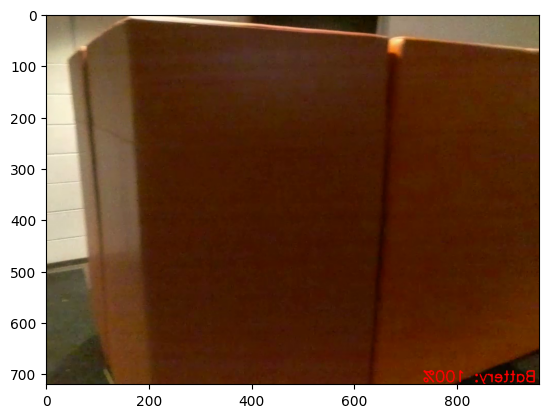

[0.0, 1.62, -28.56]


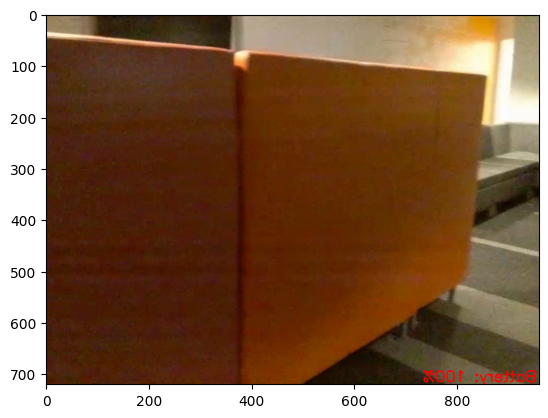

[0.0, 4.26, -28.56]


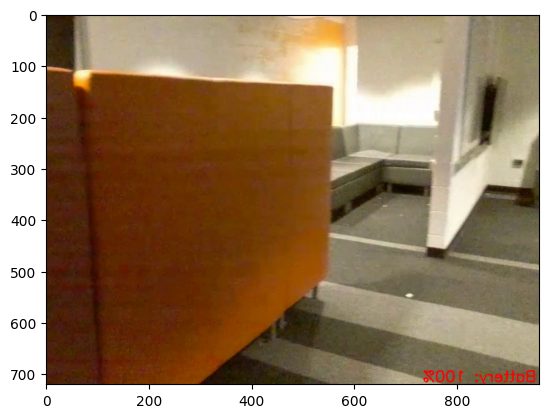

[0.0, 6.84, -28.56]


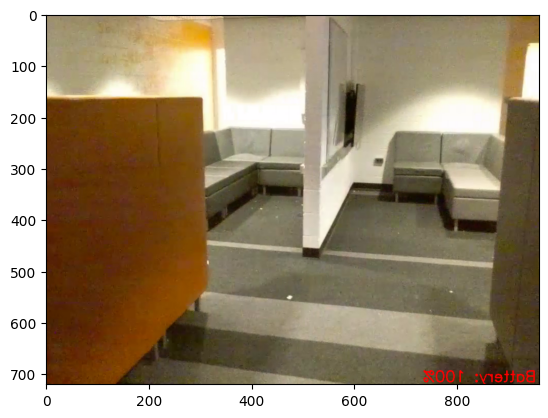

[0.0, 9.36, -28.56]


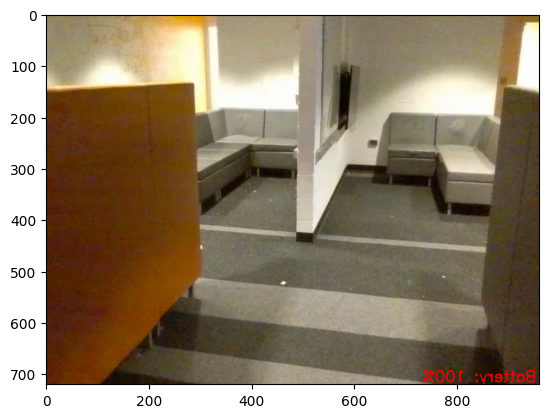

[0.0, 12.06, -28.56]


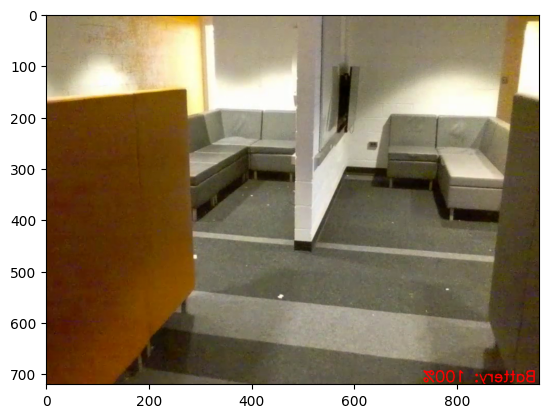

[0.0, 12.9, -28.56]


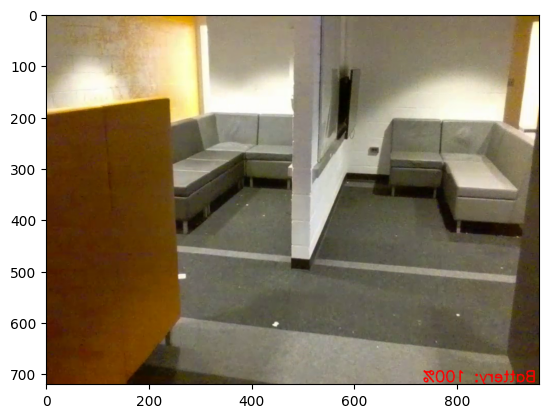

[0.0, 12.9, -28.56]


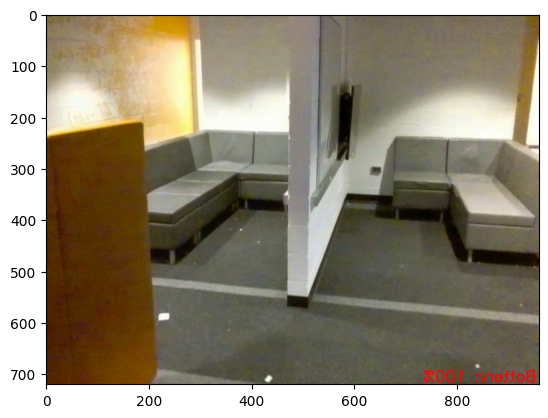

[0.0, 12.9, -28.56]


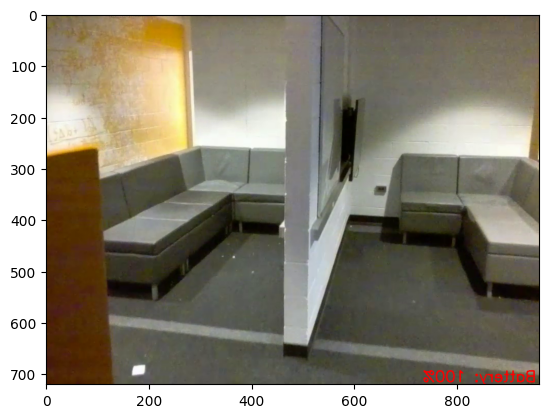

[0.0, 19.14, -57.12]


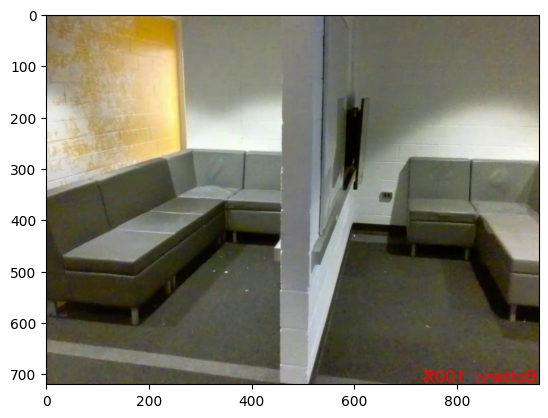

[0.0, 8.16, -28.56]


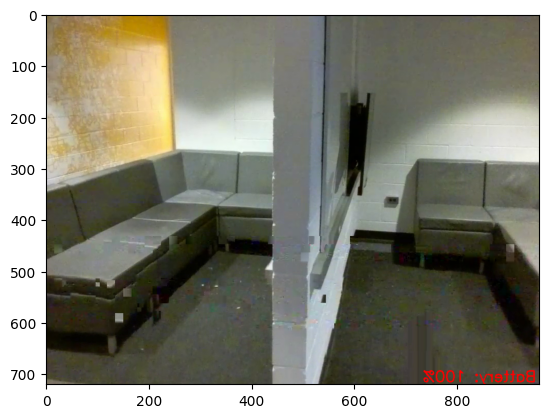

[0.0, 8.16, -28.56]


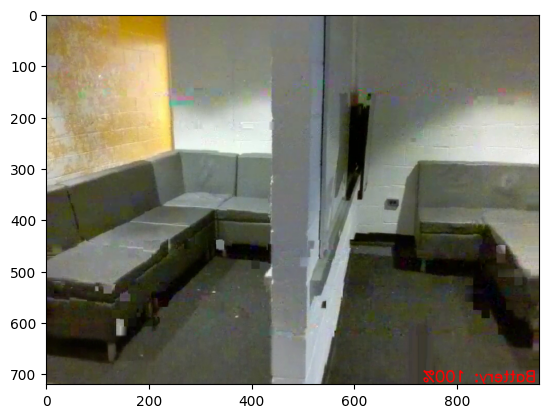

[0.0, 16.32, -57.12]


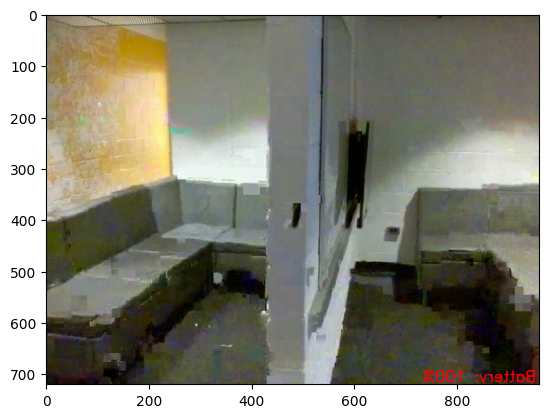

[-1.5, 8.16, -28.56]


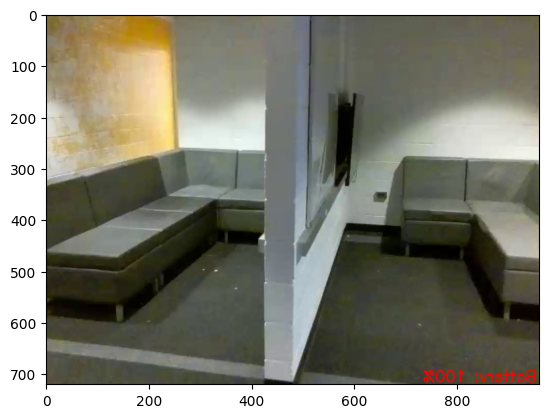

[-4.8, 16.32, -57.12]


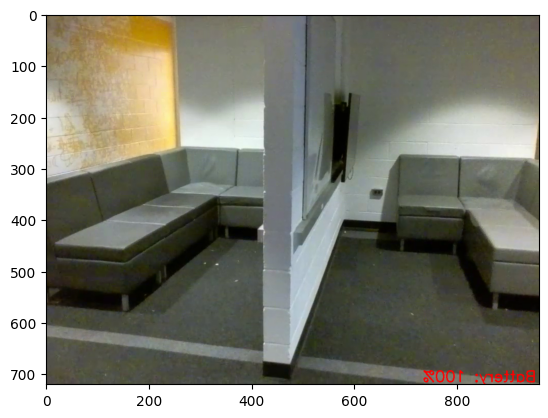

[-2.4, 8.16, -28.56]


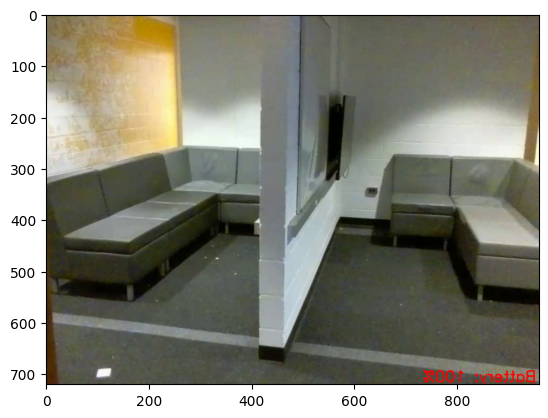

[-2.4, 8.16, -28.56]


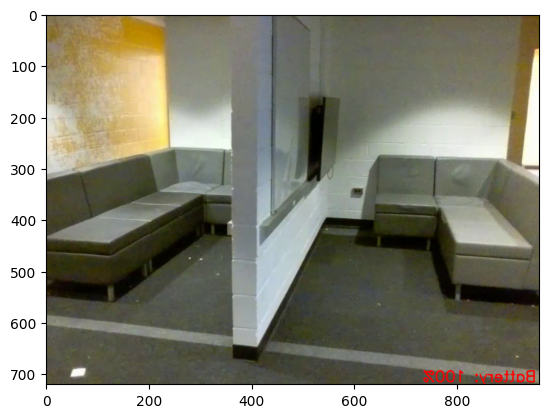

[0.0, 1.08, 0.0]


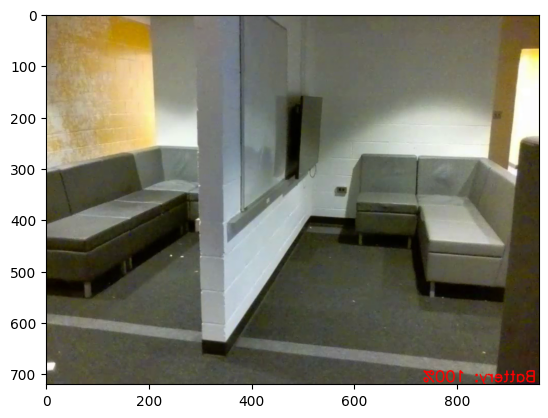

[0.0, 2.34, 0.0]


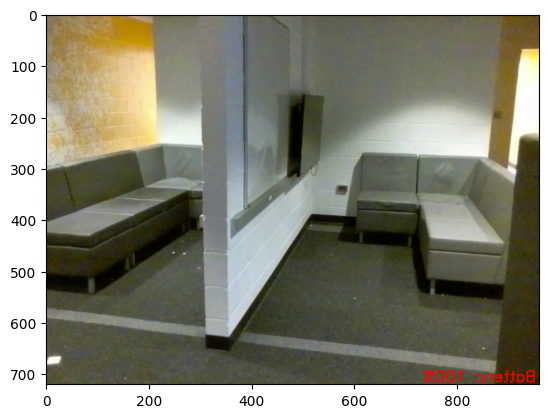

[0.0, 2.34, 0.0]


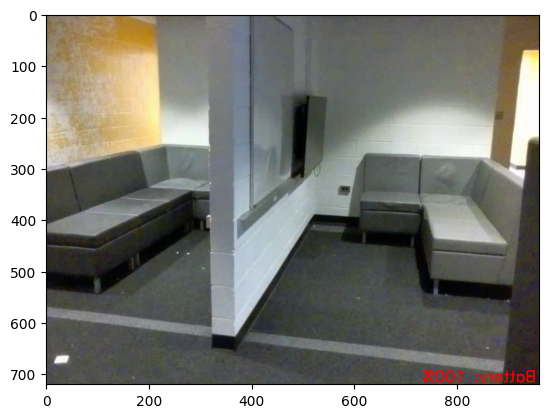

[0.0, 2.34, 0.0]


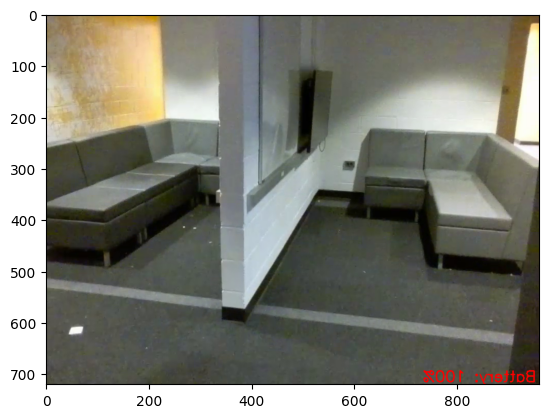

[0.0, 2.34, 0.0]


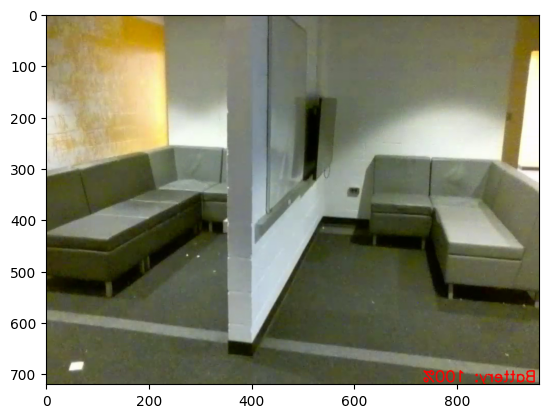

[0.0, 2.34, 0.0]


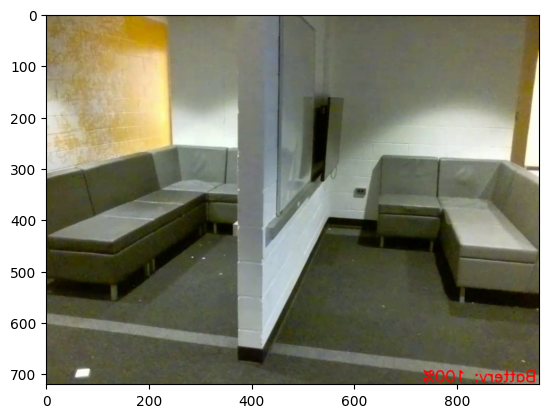

[0.0, 4.68, 0.0]


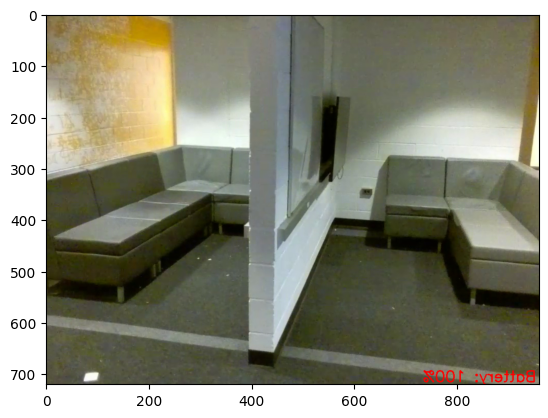

[0.0, 2.34, 0.0]


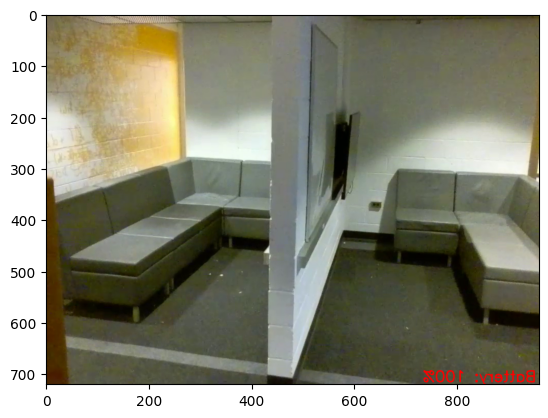

[0.0, 2.34, 0.0]


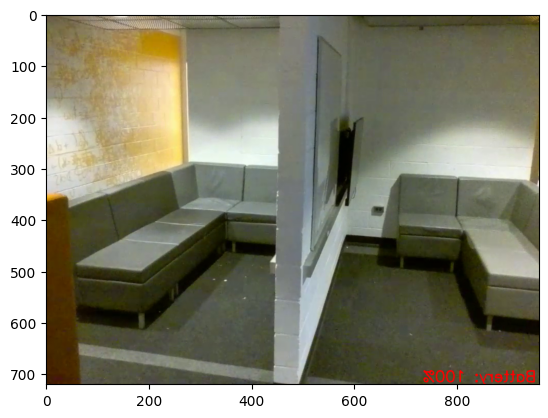

[0.0, 2.34, 0.0]


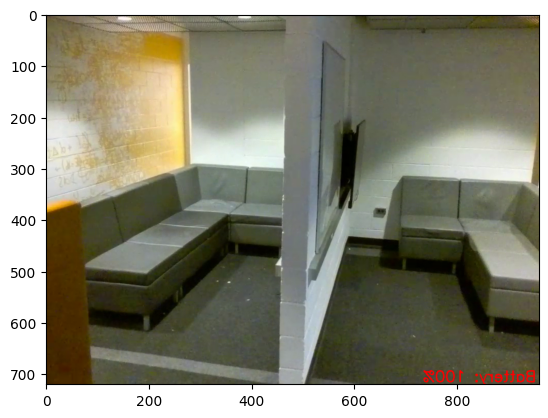

[0.0, 4.68, 0.0]


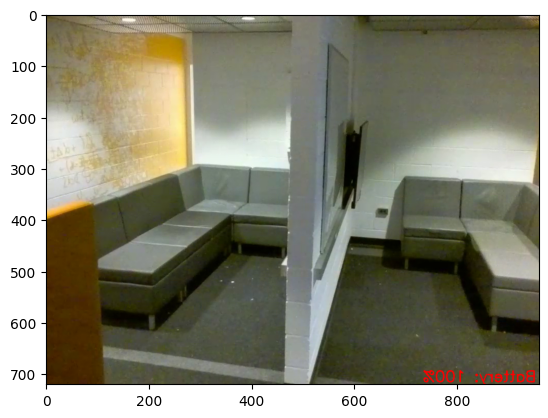

[0.0, 2.34, 0.0]


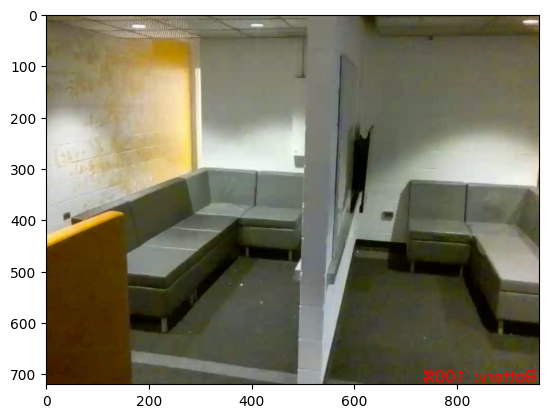

[0.0, 2.34, 0.0]


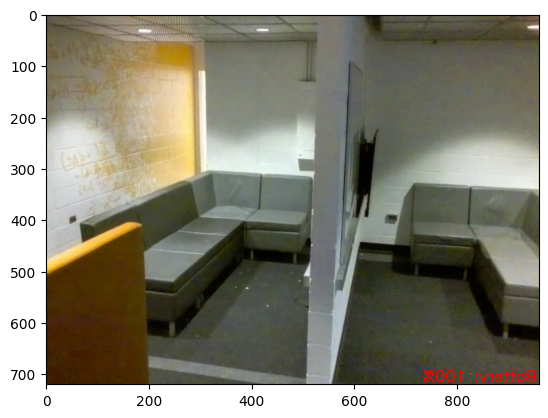

[-1.8, 2.34, 0.0]


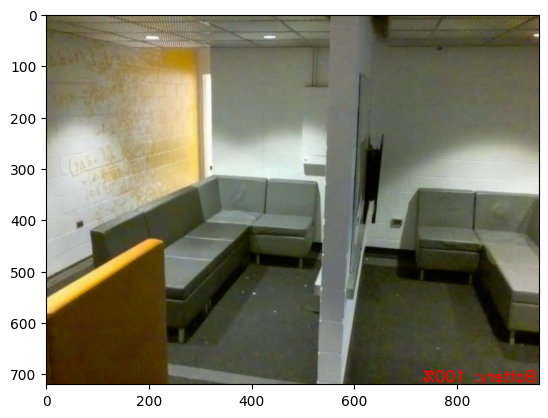

[-1.8, 2.34, 0.0]


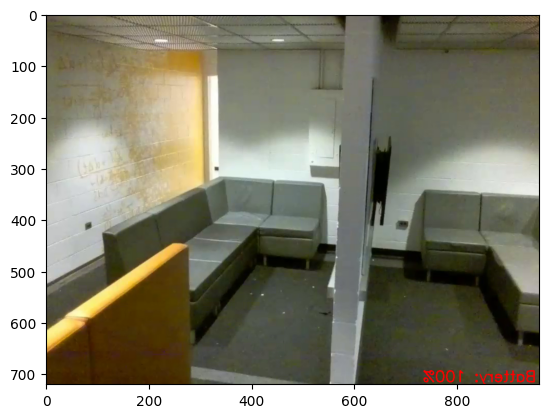

[-1.8, 2.34, 0.0]


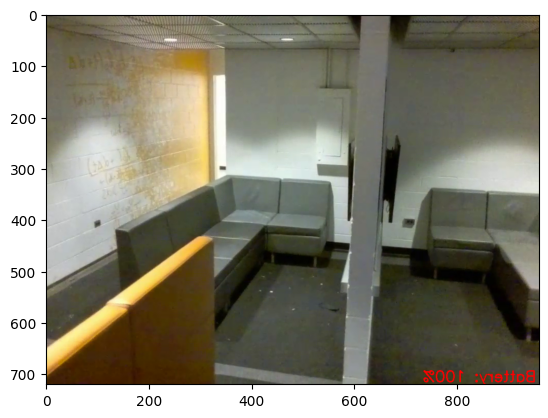

[-0.18, 2.34, 0.0]


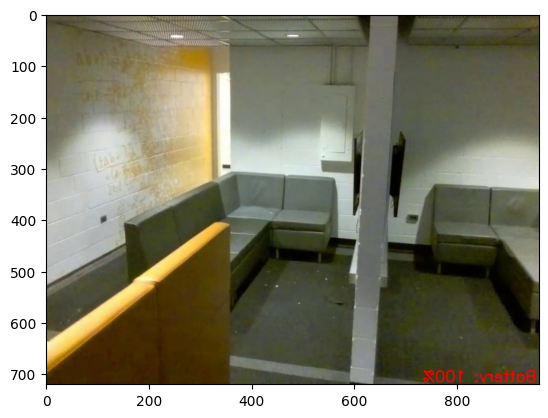

[-0.18, 2.34, 0.0]


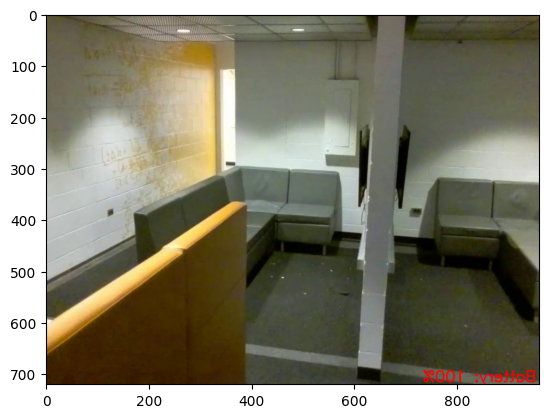

[-1.86, 2.34, 0.0]


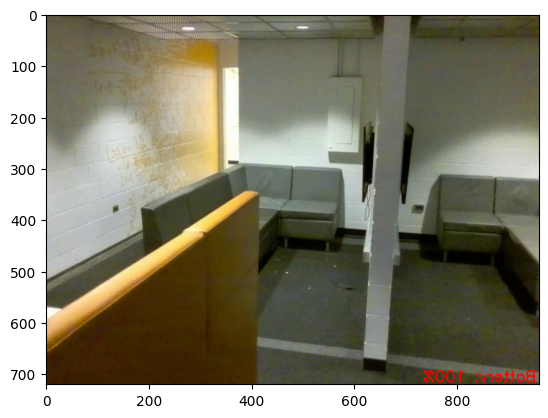

[-3.6, 2.34, 0.0]


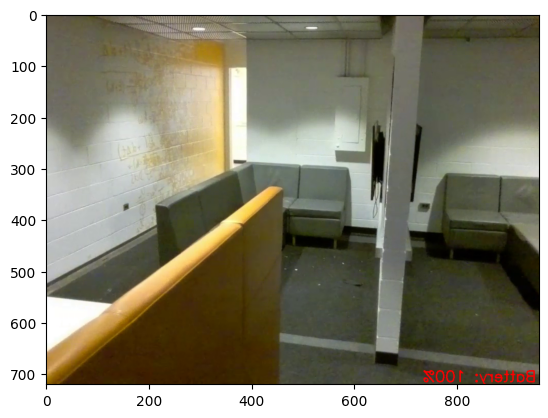

[-6.18, 2.34, 0.0]


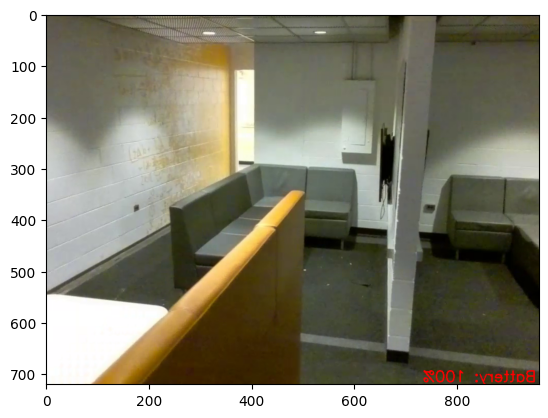

[-8.64, 2.34, 0.0]


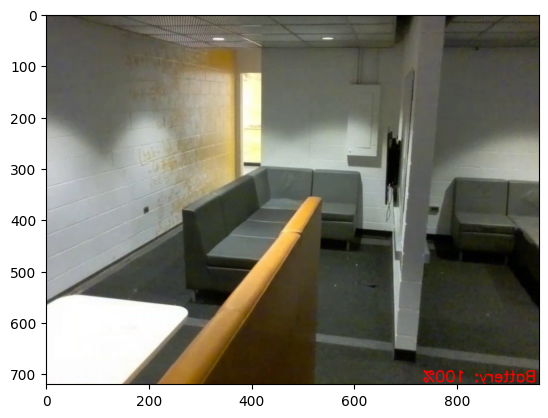

[-11.1, 2.34, 0.0]


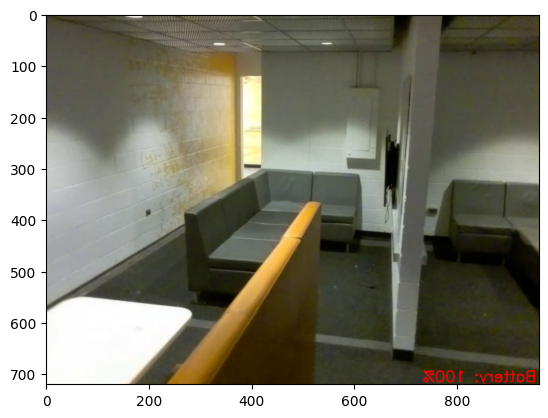

[-13.74, 2.34, 0.0]


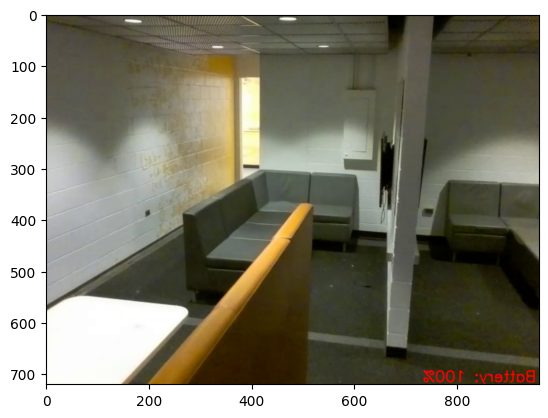

[-16.26, 2.34, 0.0]


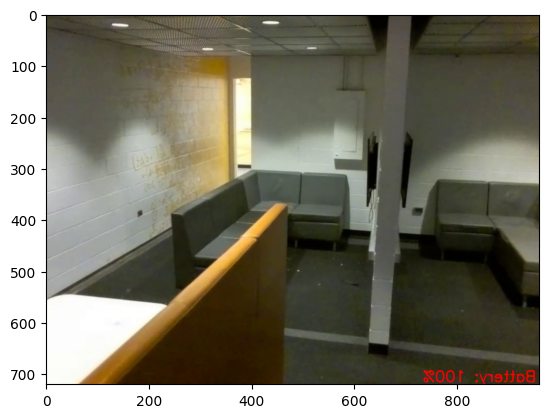

[-18.96, 2.34, 0.0]


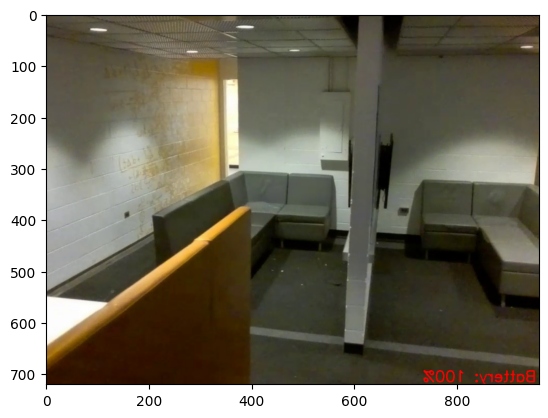

[-20.1, 2.34, 0.0]


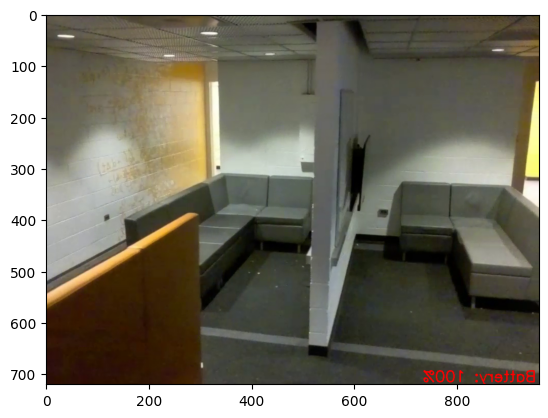

In [138]:
prev_value  = [0,0,0]
from scipy import ndimage

for key, value in trajectory.items():
    img = graph.nodes()[key]['images']
    img = ndimage.rotate(img, -90)
    plt.imshow(img)
    print([(i-j) / 1000 for i, j in zip(value ,prev_value)])
    plt.show()

In [14]:
prev_value  = [0,0,0]
from scipy import ndimage
save_matrix = []
Rotation_matrix_store = []
for key, value in trajectory.items():
    img = graph.nodes()[key]['images']
    img = ndimage.rotate(img, -90)
    # plt.imshow(img)
    current_matrix  = [(i-j) / 1000 for i, j in zip(value ,prev_value)]
    if not(type(current_matrix.index(0.0)) == int) and (0.0 in current_matrix) and  len(current_matrix.index(0.0)) > 1:
        save_matrix = [ i+j for i,j in zip(current_matrix, prev_value)]
    else:
        Rotation_matrix_store.append(current_matrix)
        save_matrix = []
    plt.show()

ValueError: 0.0 is not in list

In [12]:
current_matrix.index(0.0)

0